# HW 1 Submarine Tracking
#### Hunter Lybbert
#### Student ID 2426454
#### 01-16-25

In [1]:
import numpy as np
import matplotlib.pyplot as plt

import plotly
import plotly.graph_objs as go
from IPython.display import clear_output

In [2]:
data_path = 'data/subdata.npy'

subdata = np.load(data_path) # huge matrix of size 262144 x 49 (columns contain flattened 3d matrix of size 64x64x64)

In [3]:
# plot the data in time

# NOTE: L we defined in class is 2Lh here, i.e. the domain here is [-Lh,Lh].
Lh = 10; # length of spatial domain (cube of side L = 2*10). 
N_grid = 64; # number of grid points/Fourier modes in each direction
xx = np.linspace(-Lh, Lh, N_grid+1) #spatial grid in x dir
x = xx[0:N_grid]
y = x # same grid in y,z direction
z = x

K_grid = (2*np.pi/(2*Lh))*np.linspace(-N_grid/2, N_grid/2 -1, N_grid) # frequency grid for one coordinate

xv, yv, zv = np.meshgrid( x, y, z) # generate 3D meshgrid for plotting

# plot iso surfaces for every third measurement

# for j in range(0,49,3):
#   signal = np.reshape(subdata[:, j], (N_grid, N_grid, N_grid))
#   normal_sig_abs = np.abs(signal)/np.abs(signal).max()

#   # generate data for isosurface of the 3D data 
#   fig_data = go.Isosurface( x = xv.flatten(), y = yv.flatten(), z = zv.flatten(),
#                             value = normal_sig_abs.flatten(), isomin=0.6, isomax=1)

#   # generate plots
#   clear_output(wait=True) # need this to discard previous figs
#   fig = go.Figure( data = fig_data )
#   fig.show()


In [4]:
subdata_reshaped = subdata.reshape(64,64,64,49)

fhat_subdata = np.fft.fftn(
    subdata_reshaped,
    axes=(0,1,2),
)
fhat_shifted_subdata = np.fft.fftshift(fhat_subdata, axes=(0,1,2))
fhat_shifted_mean_subdata = fhat_shifted_subdata.mean(axis=3)
fhat_shifted_mean_subdata.max()

np.complex128(161.7270993705142+70.89908163637674j)

In [5]:
index = np.argmax(fhat_shifted_mean_subdata)
index

np.int64(162890)

In [6]:
fhat_shifted_mean_subdata.flatten()[index]

np.complex128(161.7270993705142+70.89908163637674j)

In [7]:
indices = np.unravel_index([index], (64,64,64))
indices

(array([39]), array([49]), array([10]))

In [8]:
fhat_shifted_mean_subdata[indices]

array([161.72709937+70.89908164j])

In [9]:
kx, ky, kz = np.meshgrid(K_grid, K_grid, K_grid)
kx0, ky0, kz0 = kx[indices], ky[indices], kz[indices]
kx0, ky0, kz0

(array([5.34070751]), array([2.19911486]), array([-6.91150384]))

In [11]:
sigma = 2

gaussian_filter = (1 / np.sqrt( 2 * np.pi * sigma**2)) * np.exp( (1/(sigma**2)) * ((- (kx - kx0)**2 - (ky - ky0)**2 - (kz - kz0)**2) ) )

expanded_filter = np.expand_dims(gaussian_filter, axis=3)

In [12]:
fhat_shifted_subdata_filtered = fhat_shifted_subdata * expanded_filter

In [13]:
filtered_signal = np.fft.ifftn(
    # fhat_shifted_subdata_filtered,
    np.fft.ifftshift(
        fhat_shifted_subdata_filtered,
        axes=(0, 1, 2)
    ),
        axes=(0,1,2)
)

In [14]:
locations = []

for i in range(49):
    signal_time_slice = filtered_signal[:,:,:,i]

    index = np.argmax(np.abs(signal_time_slice))

    indices = np.unravel_index([index], (64,64,64))
    locations.append(np.array([kx[indices][0], ky[indices][0], kz[indices][0]]))

location_data = np.vstack(locations)

In [20]:
from IPython.display import HTML
import matplotlib.animation as animation

def create_animation(location_data: np.array, save: bool):
    """Create animation of the system as time evolved."""
    animation.writer = animation.writers['ffmpeg']

    plt.ioff()
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')

    sub_part, = plt.plot([],[],[], 'dodgerblue', markersize=4, marker='o')
    sub_traj, = plt.plot([],[],[], 'dodgerblue', label="Sub")

    # write the update function, specifically including the ax.clear() function this was important.
    def update(i):
        sub_part.set_data(location_data[i,0], location_data[i,1])
        sub_part.set_3d_properties(location_data[i,2])
        sub_traj.set_data(location_data[:i+1,0],location_data[:i+1,1])
        sub_traj.set_3d_properties(location_data[:i+1,2])

        # ax.plot(location_data[:,0], location_data[:,1], location_data[:,2], '-o', color='orange', markersize=2)
        return sub_part, sub_traj

    ani = animation.FuncAnimation(fig, update, frames=range(48), interval=25)
    return ani

In [21]:
location_data.shape

(49, 3)

In [22]:
ani = create_animation(location_data, save=False)
file_name = "visualizations/filtered_subdata.gif"
ani.save(file_name, writer='pillow')

IndexError: list index out of range

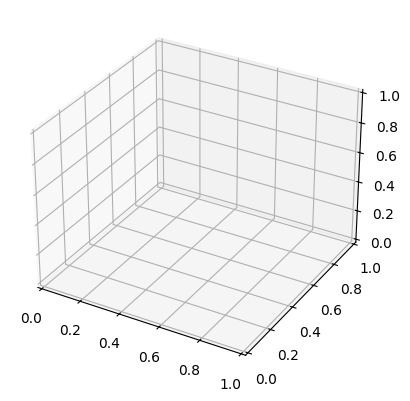

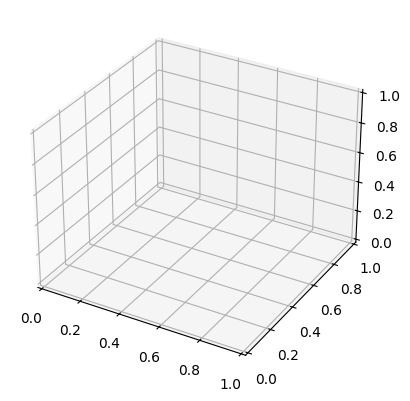

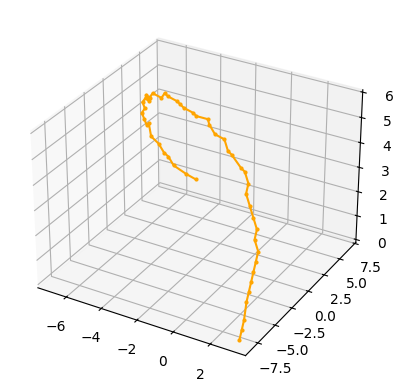

In [23]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# ax.set_xlim((-10, 10))
# ax.set_ylim((-10, 10))
# ax.set_zlim((-10, 10))

plt.plot(location_data[:,0], location_data[:,1], location_data[:,2], '-o', color='orange', markersize=2)
plt.show()

In [45]:
this = fhat_shifted_subdata.mean(axis=3)

vmin = np.abs(this.min())
vmax = np.abs(this.max())

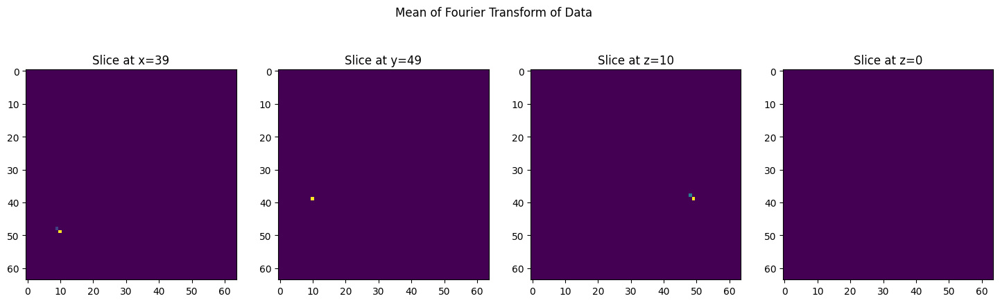

In [48]:
fig, ax = plt.subplots(1,4, figsize=(18,5))

ax[0].imshow(np.abs(fhat_shifted_subdata.mean(axis=3)[39,:,:]), vmin=vmin, vmax=vmax)
ax[0].set_title('Slice at x=39')

ax[1].imshow(np.abs(fhat_shifted_subdata.mean(axis=3)[:,49,:]), vmin=vmin, vmax=vmax)
ax[1].set_title('Slice at y=49')

ax[2].imshow(np.abs(fhat_shifted_subdata.mean(axis=3)[:,:,10]), vmin=vmin, vmax=vmax)
ax[2].set_title('Slice at z=10')

ax[3].imshow(np.abs(fhat_shifted_subdata.mean(axis=3)[:,:,0]), vmin=vmin, vmax=vmax)
ax[3].set_title('Slice at z=0')

plt.suptitle('Mean of Fourier Transform of Data')
plt.show()

In [13]:
# first = subdata[:,0]

# plt.plot(first.reshape((64,64,64))[:,:,0], marker='.')
# plt.show()

In [23]:
def plot_3d(data, n):
    signal = np.reshape(subdata[:, n], (N_grid, N_grid, N_grid))
    normal_sig_abs = np.abs(signal)/np.abs(signal).max()

    # generate data for isosurface of the 3D data 
    fig_data = go.Isosurface( x = xv.flatten(), y = yv.flatten(), z = zv.flatten(),
                            value = normal_sig_abs.flatten()) #, isomin=.7, isomax=1)
                            # value = signal.real.flatten(), isomin=.6, isomax=1)

    # generate plots
    clear_output(wait=True) # need this to discard previous figs
    fig = go.Figure( data = fig_data )
    fig.show()       

plot_3d(subdata.reshape(64,64,64,49), 0)

Max average frequency the signal across time...
* Apply fft to each time sample independentantly and average the samples
* Averaging gets rid of a little noise
* 

Filtering:
* Filter in the frequency domain like the fft.ipynb notebook

An extra Idea:
* Consider filtering in the signal domain (this one would require the gabor filter)